<a href="https://colab.research.google.com/github/electrodrago/generative-AI/blob/main/advanced_gan_facegen.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Face generate with Pytorch



## Libraries

In [1]:
import torch, torchvision, os, PIL, pdb
from torch import nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import numpy as np
from PIL import Image

import matplotlib.pyplot as plt


## Hyperparameter & general parameter

In [2]:
n_epochs = 10000
batch_size = 128
lr = 1e-4

z_dim = 200
device = 'cuda'

cur_step = 0
crit_cycles = 5

gen_losses = []
crit_losses = []
show_step = 35                                                                    # Showing image
save_step = 35                                                                    # Saving checkpoint

wandbact = 1                                                                      # Yes, we want to track stats through weights and biases, optional

## Show function

In [3]:
def show(tensor, num=25, wandbactive=0, name=''):
  data = tensor.detach().cpu()
  grid = make_grid(data[:num], nrow=5).permute(1,2,0)

  if (wandbactive == 1):
    wandb.log({name:wandb.Image(grid.numpy().clip(0,1))})

  plt.imshow(grid.clip(0,1))
  plt.show()

## Setup weights and biases API

In [4]:
!pip install wandb -qqq
import wandb
wandb.login(key='f0405905456138aedbf2549a226eb5511fa5d6c9')

     |████████████████████████████████| 1.8 MB 4.9 MB/s 
     |████████████████████████████████| 145 kB 59.9 MB/s 
     |████████████████████████████████| 181 kB 71.0 MB/s 
     |████████████████████████████████| 63 kB 2.2 MB/s 


wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

## Training process

In [5]:
%%capture
experiment_name = wandb.util.generate_id()
myrun = wandb.init(
    project='wgan',
    group=experiment_name,
    config={
        "optimizer": "adam",
        "model": "wgan gp",
        "epoch": "1000",
        "batch_size": 128
    }
)

config = wandb.config

In [6]:
print(experiment_name)

3omgotxl


## Generator

Calculating new width and height:

`(n - 1) * stride - 2 * padding + kernel_size`

ConvTranspose2d: in_channels, out_channels, kernel_size, stride = 1, padding = 0

In [7]:
from torch.nn.modules.activation import ReLU
class Generator(nn.Module):
  def __init__(self, z_dim=64, d_dim=16):
    super(Generator, self).__init__()

    self.z_dim = z_dim
    
    self.gen = nn.Sequential(
        # Begin with 1 x 1 (channel: 200) image
        # After the next ConvTranspose2d --> 4 x 4 (channel: 512)
        nn.ConvTranspose2d(z_dim, d_dim * 32, 4, 1, 0),
        nn.BatchNorm2d(d_dim * 32),
        nn.ReLU(True),

        # After the next ConvTranspose2d --> 8 x 8 (channel: 256)
        nn.ConvTranspose2d(d_dim * 32, d_dim * 16, 4, 2, 1),
        nn.BatchNorm2d(d_dim * 16),
        nn.ReLU(True),

        # After the next ConvTranspose2d --> 16 x 16 (channel: 128)
        nn.ConvTranspose2d(d_dim * 16, d_dim * 8, 4, 2, 1),
        nn.BatchNorm2d(d_dim * 8),
        nn.ReLU(True),

        # After the next ConvTranspose2d --> 32 x 32 (channel: 64)
        nn.ConvTranspose2d(d_dim * 8, d_dim * 4, 4, 2, 1),
        nn.BatchNorm2d(d_dim * 4),
        nn.ReLU(True),

        # After the next ConvTranspose2d --> 64 x 64 (channel: 32)
        nn.ConvTranspose2d(d_dim * 4, d_dim * 2, 4, 2, 1),
        nn.BatchNorm2d(d_dim * 2),
        nn.ReLU(True),

        # After the next ConvTranspose2d --> 128 x 128 (channel: 3)
        nn.ConvTranspose2d(d_dim * 2, 3, 4, 2, 1),
        nn.Tanh() # Product result in the range from -1 to 1
    )
  
  def forward(self, noise):
    x = noise.view(len(noise), self.z_dim, 1, 1) # 128 x 200 x 1 x 1
    return self.gen(x)

def gen_noise(num, z_dim, device='cuda'):
  return torch.randn(num, z_dim, device=device)

## Critic

In [8]:
class Critic(nn.Module):
  def __init__(self, d_dim=16):
    super(Critic, self).__init__()
    self.crit = nn.Sequential(
        nn.Conv2d(3, d_dim, 4, 2, 1), # 128 x 128 x 3 --> 64 x 64 x 16
        nn.InstanceNorm2d(d_dim),
        nn.LeakyReLU(0.2),
        
        nn.Conv2d(d_dim, d_dim * 2, 4, 2, 1), # 64 x 64 x 16 --> 32 x 32 x 32
        nn.InstanceNorm2d(d_dim * 2),
        nn.LeakyReLU(0.2),

        nn.Conv2d(d_dim * 2, d_dim * 4, 4, 2, 1), # 32 x 32 x 32 --> 16 x 16 x 64
        nn.InstanceNorm2d(d_dim * 4),
        nn.LeakyReLU(0.2),

        nn.Conv2d(d_dim * 4, d_dim * 8, 4, 2, 1), # 16 x 16 x 64 --> 8 x 8 x 128
        nn.InstanceNorm2d(d_dim * 8),
        nn.LeakyReLU(0.2),

        nn.Conv2d(d_dim * 8, d_dim * 16, 4, 2, 1), # 8 x 8 x 128 --> 4 x 4 x 256
        nn.InstanceNorm2d(d_dim * 16),
        nn.LeakyReLU(0.2),

        nn.Conv2d(d_dim * 16, 1, 4, 1, 0) 
    )
  
  def forward(self, image):
    # image 128 x 3 x 128 x 128
    crit_pred = self.crit(image)
    return crit_pred.view(len(crit_pred), -1) # 128 x 1

## Dataset

In [9]:
!gdown --id 1OL7qLVlwEbL--MK8gpsp5rIdp0v8_qmZ


/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1OL7qLVlwEbL--MK8gpsp5rIdp0v8_qmZ
To: /content/archive.zip
100% 1.43G/1.43G [00:13<00:00, 107MB/s]


In [10]:
!unzip "/content/archive.zip" -d "/content/"

Streaming output truncated to the last 5000 lines.
  inflating: /content/img_align_celeba/img_align_celeba/197604.jpg  
  inflating: /content/img_align_celeba/img_align_celeba/197605.jpg  
  inflating: /content/img_align_celeba/img_align_celeba/197606.jpg  
  inflating: /content/img_align_celeba/img_align_celeba/197607.jpg  
  inflating: /content/img_align_celeba/img_align_celeba/197608.jpg  
  inflating: /content/img_align_celeba/img_align_celeba/197609.jpg  
  inflating: /content/img_align_celeba/img_align_celeba/197610.jpg  
  inflating: /content/img_align_celeba/img_align_celeba/197611.jpg  
  inflating: /content/img_align_celeba/img_align_celeba/197612.jpg  
  inflating: /content/img_align_celeba/img_align_celeba/197613.jpg  
  inflating: /content/img_align_celeba/img_align_celeba/197614.jpg  
  inflating: /content/img_align_celeba/img_align_celeba/197615.jpg  
  inflating: /content/img_align_celeba/img_align_celeba/197616.jpg  
  inflating: /content/img_align_celeba/img_align_cel

In [11]:
path = "/content/img_align_celeba/img_align_celeba"

## Dataset

In [12]:
class Dataset(Dataset):
  def __init__(self, path, size=128, lim=10000):
    self.sizes = [size, size]
    items, labels = [], []
    
    for data in os.listdir(path)[:lim]:
      item = os.path.join(path, data)
      items.append(item)
      labels.append(data)
    
    self.items = items
    self.labels = labels

  def __len__(self):
    return len(self.items)
  
  def __getitem__(self, index):
    data = PIL.Image.open(self.items[index]).convert('RGB')
    data = np.asarray(torchvision.transforms.Resize(self.sizes)(data)) # 128 x 128 x 3
    data = np.transpose(data, (2,0,1)).astype(np.float32, copy=False) # 3 x 128 x 128
    data = torch.from_numpy(data).div(255)
    return data, self.labels[index]
  

In [13]:
ds = Dataset(path, 128, 10000)

In [14]:
ds[1]

(tensor([[[0.4980, 0.4941, 0.4980,  ..., 0.4039, 0.4039, 0.4039],
          [0.4980, 0.4941, 0.4980,  ..., 0.4039, 0.4039, 0.4039],
          [0.4980, 0.4941, 0.4980,  ..., 0.4039, 0.4039, 0.4039],
          ...,
          [0.4510, 0.4510, 0.4549,  ..., 0.4667, 0.4588, 0.4353],
          [0.4392, 0.4471, 0.4510,  ..., 0.4549, 0.4588, 0.4471],
          [0.4392, 0.4431, 0.4471,  ..., 0.4667, 0.4706, 0.4667]],
 
         [[0.4941, 0.4902, 0.4941,  ..., 0.3961, 0.3961, 0.3961],
          [0.4941, 0.4902, 0.4941,  ..., 0.3961, 0.3961, 0.3961],
          [0.4941, 0.4902, 0.4941,  ..., 0.3961, 0.3961, 0.3961],
          ...,
          [0.4471, 0.4471, 0.4510,  ..., 0.4588, 0.4588, 0.4510],
          [0.4353, 0.4431, 0.4471,  ..., 0.4431, 0.4510, 0.4431],
          [0.4353, 0.4392, 0.4431,  ..., 0.4392, 0.4431, 0.4392]],
 
         [[0.5176, 0.5137, 0.5176,  ..., 0.4392, 0.4392, 0.4392],
          [0.5176, 0.5137, 0.5176,  ..., 0.4392, 0.4392, 0.4392],
          [0.5176, 0.5137, 0.5176,  ...,

## Dataloader

In [15]:
dataloader = DataLoader(ds, batch_size=batch_size, shuffle=True)

## Model

In [16]:
gen = Generator(z_dim).to(device)
crit = Critic().to(device)

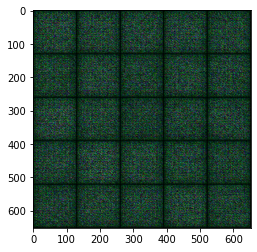

In [17]:
a = gen_noise(128, z_dim)
b = gen(a)
show(b)

## Optimizer

In [18]:
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(0.5, 0.9))
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(0.5, 0.9))

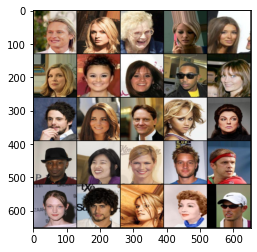

In [19]:
if wandbact == 1:
  wandb.watch(gen, log_freq=100)
  wandb.watch(crit, log_freq=100)

x, y = next(iter(dataloader))
show(x)

## Gradient penalty

In [20]:
def get_gp(real, fake, crit, alpha, gamma=10):
  mix_images = real * alpha + fake * (1 - alpha) # 128 x 3 x 128 x 128
  mix_scores = crit(mix_images) # 128 x 1

  gradient = torch.autograd.grad(
      inputs = mix_images,
      outputs = mix_scores,
      grad_outputs = torch.ones_like(mix_scores),
      retain_graph=True,
      create_graph=True
  )[0] # 128 x 3 x 128 x 128

  gradient = gradient.view(len(gradient), -1)
  gradient_norm = gradient.norm(2, dim=1)
  gp = gamma * ((gradient_norm - 1)**2).mean()

  return gp

## Save and load checkpoints

In [21]:
root_path = "/content/img_align_celeba/"

def save_checkpoint(name):
  torch.save({
      'epoch': epoch,
      'model_state_dict': gen.state_dict(),
      'optimizer_state_dict': gen_opt.state_dict()
  }, f"{root_path}G-{name}.pkl")

  torch.save({
      'epoch': epoch,
      'model_state_dict': crit.state_dict(),
      'optimizer_state_dict': crit_opt.state_dict()
  }, f"{root_path}C-{name}.pkl")
  print("Saved checkpoint")

def load_checkpoint(name):
  checkpoint = torch.load(f"{root_path}G-{name}.pkl")
  gen.load_state_dict(checkpoint['model_state_dict'])
  gen_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  checkpoint = torch.load(f"{root_path}C-{name}.pkl")
  crit.load_state_dict(checkpoint['model_state_dict'])
  crit_opt.load_state_dict(checkpoint['optimizer_state_dict'])
  print("Loaded checkpoint")

In [22]:
epoch = 0
save_checkpoint("test")

Saved checkpoint


In [23]:
load_checkpoint('test')

Loaded checkpoint


## Training loop


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  35 35
Saved checkpoint


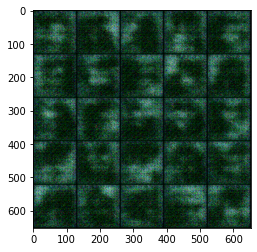

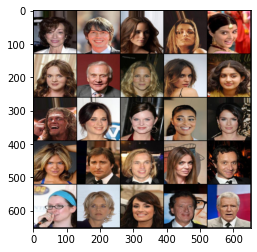

Epoch: 0: Step 35: Generator loss: 9.691288078682764, critic loss: -8.88548788019589


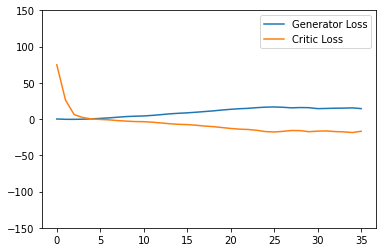

Saving checkpoint:  70 35
Saved checkpoint


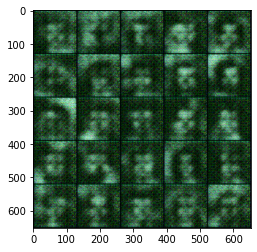

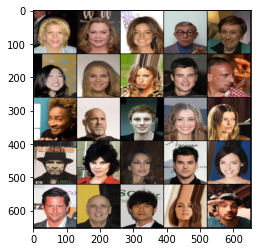

Epoch: 0: Step 70: Generator loss: 22.66206340789795, critic loss: -25.52244406563895


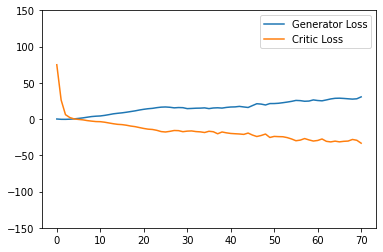

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  105 35
Saved checkpoint


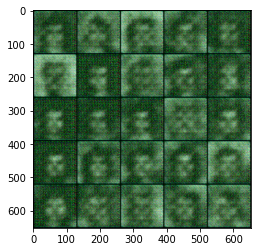

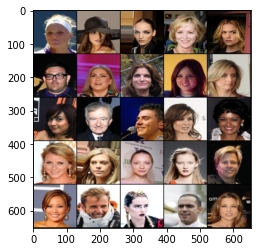

Epoch: 1: Step 105: Generator loss: 29.186738749912806, critic loss: -31.506673169817248


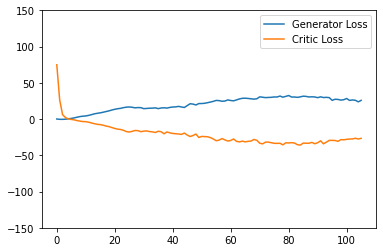

Saving checkpoint:  140 35
Saved checkpoint


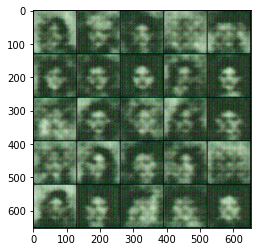

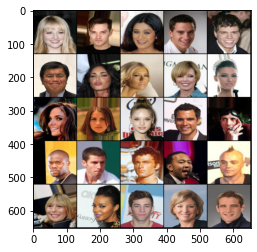

Epoch: 1: Step 140: Generator loss: 24.56807294573103, critic loss: -23.79371481759207


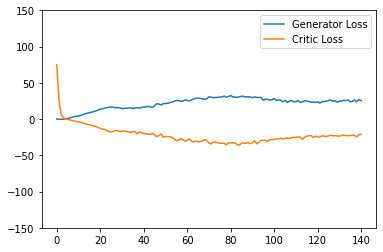

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  175 35
Saved checkpoint


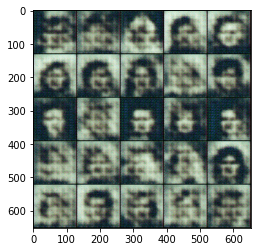

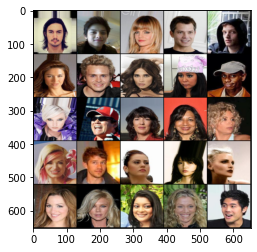

Epoch: 2: Step 175: Generator loss: 26.352189036778043, critic loss: -20.376852771214075


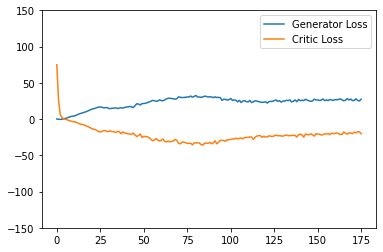

Saving checkpoint:  210 35
Saved checkpoint


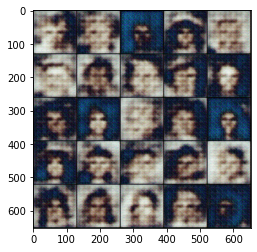

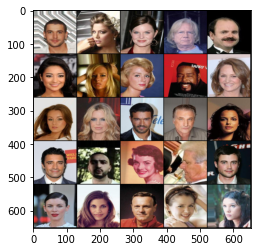

Epoch: 2: Step 210: Generator loss: 23.905562809535436, critic loss: -16.686975119454512


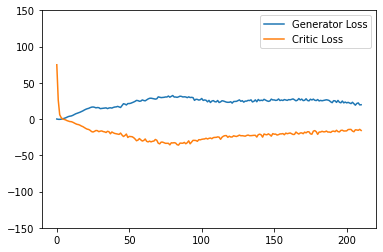

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  245 35
Saved checkpoint


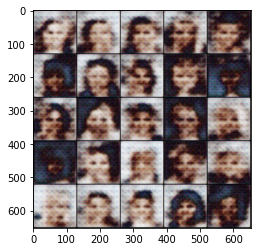

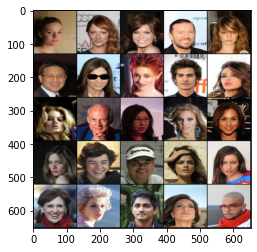

Epoch: 3: Step 245: Generator loss: 19.45605959211077, critic loss: -14.871424805777416


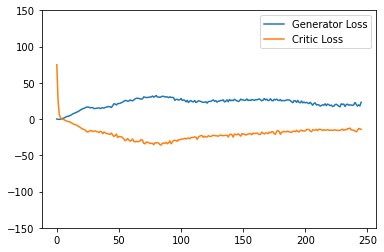

Saving checkpoint:  280 35
Saved checkpoint


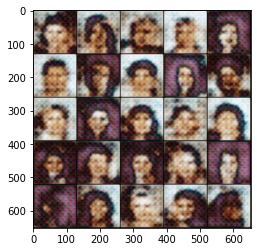

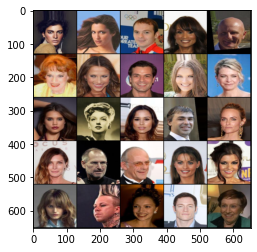

Epoch: 3: Step 280: Generator loss: 21.857218824114117, critic loss: -14.276031723022458


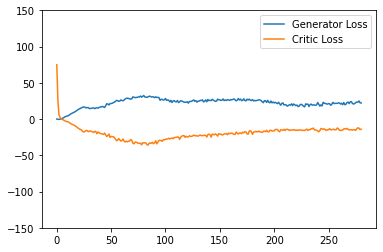

Saving checkpoint:  315 35
Saved checkpoint


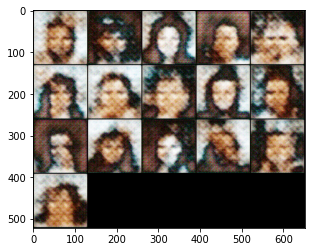

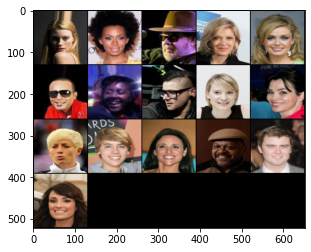

Epoch: 3: Step 315: Generator loss: 22.391084997994557, critic loss: -13.880176064627513


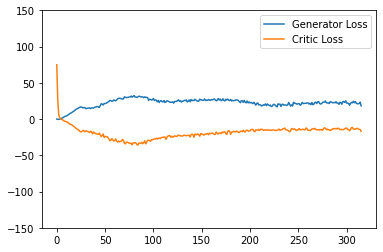

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  350 35
Saved checkpoint


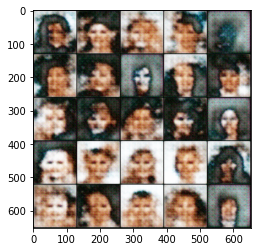

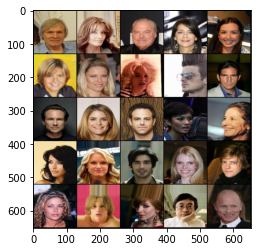

Epoch: 4: Step 350: Generator loss: 23.43332279750279, critic loss: -13.576066458565846


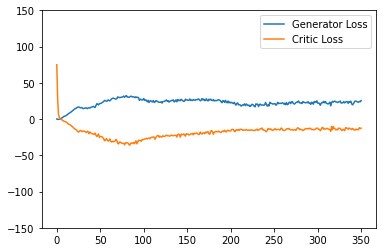

Saving checkpoint:  385 35
Saved checkpoint


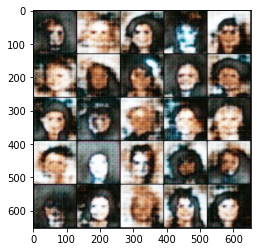

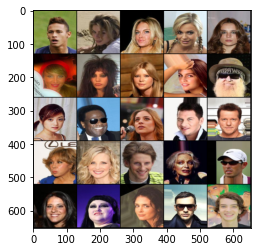

Epoch: 4: Step 385: Generator loss: 24.09660611833845, critic loss: -13.408341464996338


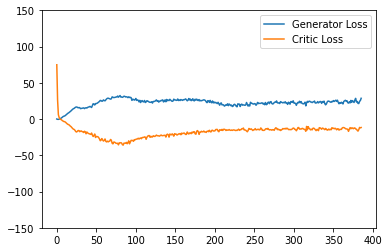

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  420 35
Saved checkpoint


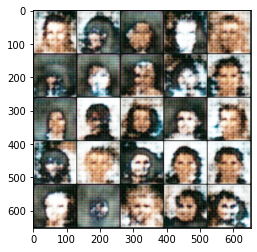

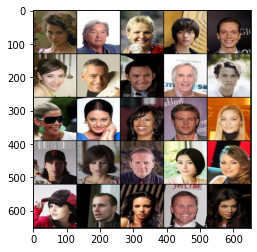

Epoch: 5: Step 420: Generator loss: 24.618609183175224, critic loss: -12.880371189117433


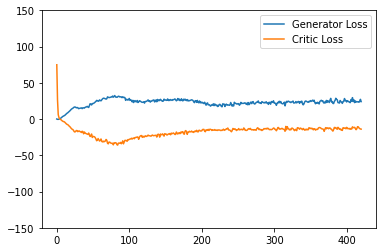

Saving checkpoint:  455 35
Saved checkpoint


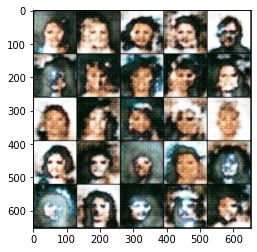

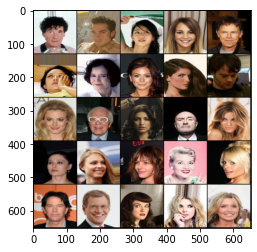

Epoch: 5: Step 455: Generator loss: 25.07079898289272, critic loss: -12.381299555642263


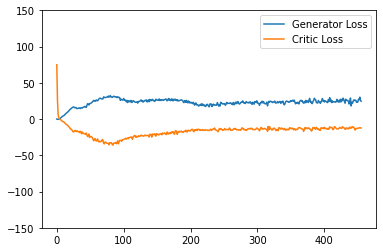

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  490 35
Saved checkpoint


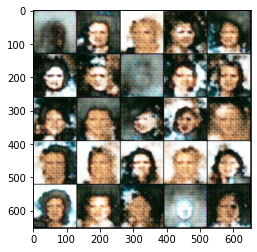

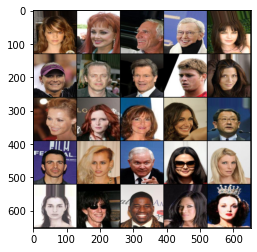

Epoch: 6: Step 490: Generator loss: 24.98837536403111, critic loss: -12.005154170989991


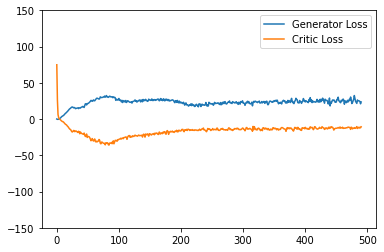

Saving checkpoint:  525 35
Saved checkpoint


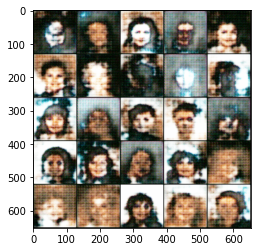

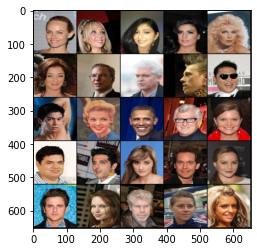

Epoch: 6: Step 525: Generator loss: 25.766304234095983, critic loss: -11.891260896410257


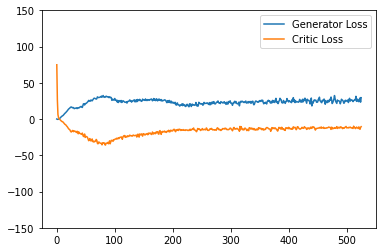

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  560 35
Saved checkpoint


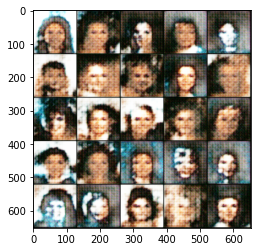

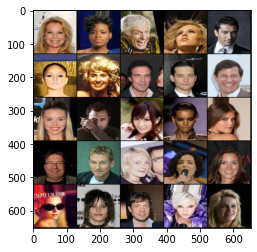

Epoch: 7: Step 560: Generator loss: 25.57779884338379, critic loss: -11.290228353227889


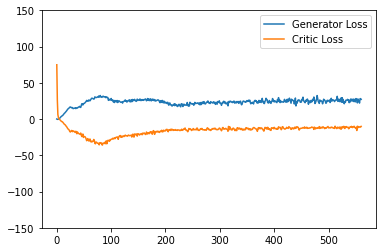

Saving checkpoint:  595 35
Saved checkpoint


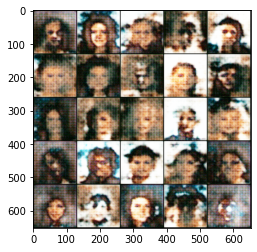

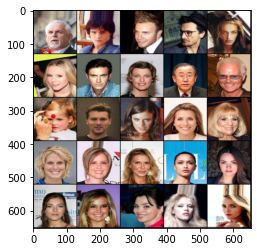

Epoch: 7: Step 595: Generator loss: 26.10854688371931, critic loss: -11.017214033944267


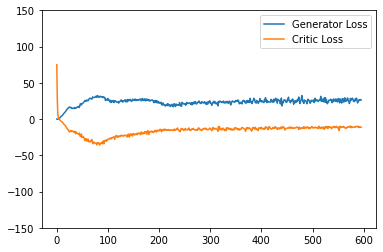

Saving checkpoint:  630 35
Saved checkpoint


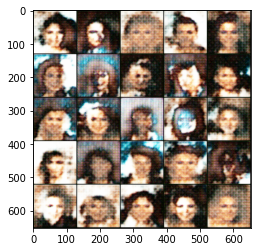

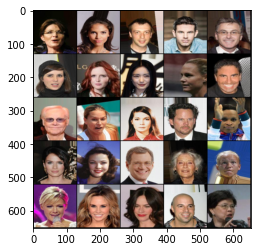

Epoch: 7: Step 630: Generator loss: 26.143910326276508, critic loss: -10.879333784920833


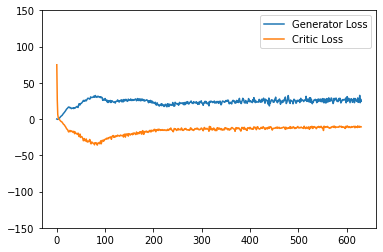

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  665 35
Saved checkpoint


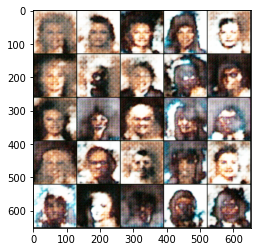

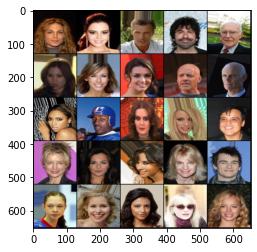

Epoch: 8: Step 665: Generator loss: 26.284900338309154, critic loss: -10.753769629342216


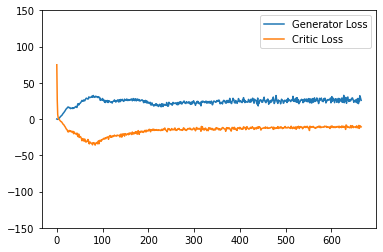

Saving checkpoint:  700 35
Saved checkpoint


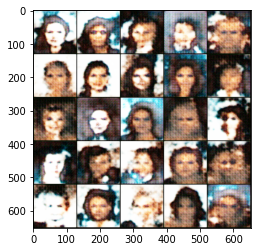

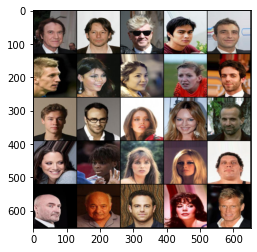

Epoch: 8: Step 700: Generator loss: 27.28416873386928, critic loss: -10.605902115958077


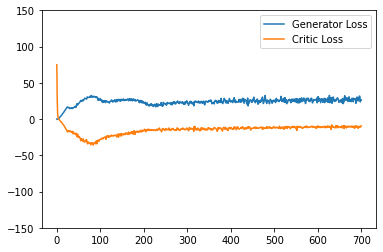

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  735 35
Saved checkpoint


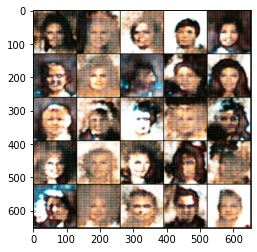

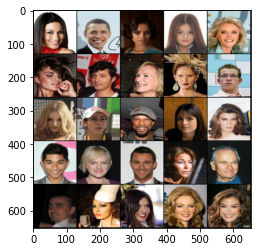

Epoch: 9: Step 735: Generator loss: 27.444827815464564, critic loss: -10.598829934256415


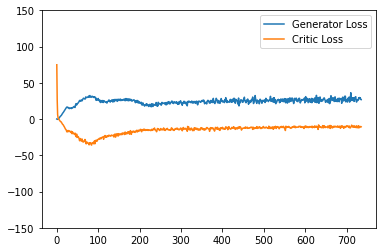

Saving checkpoint:  770 35
Saved checkpoint


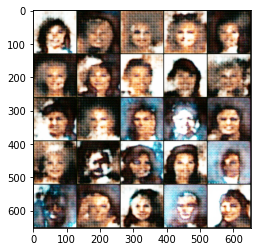

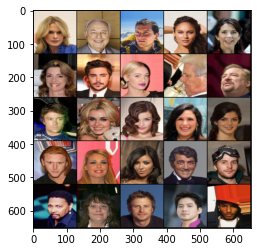

Epoch: 9: Step 770: Generator loss: 27.948965181623187, critic loss: -10.326120292118617


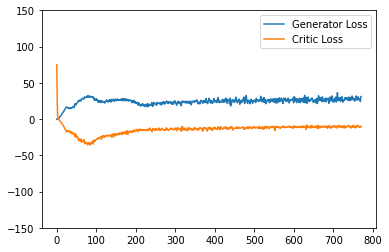

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  805 35
Saved checkpoint


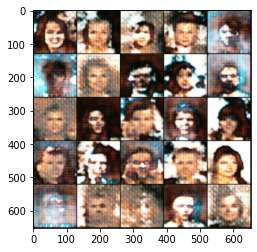

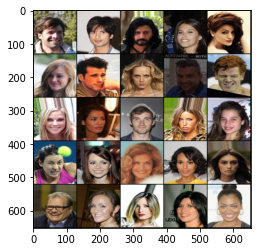

Epoch: 10: Step 805: Generator loss: 27.589324951171875, critic loss: -10.228809176853726


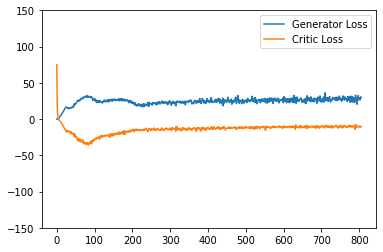

Saving checkpoint:  840 35
Saved checkpoint


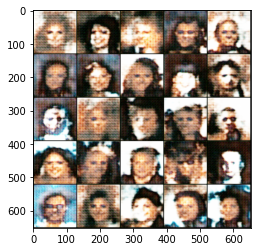

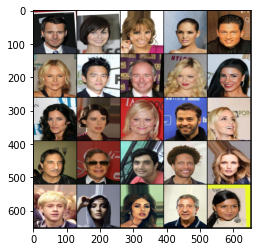

Epoch: 10: Step 840: Generator loss: 28.864264025006975, critic loss: -10.267424297332761


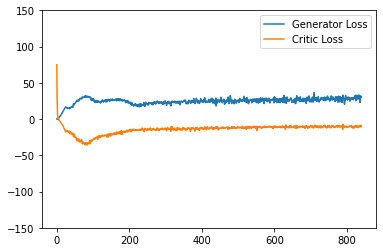

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  875 35
Saved checkpoint


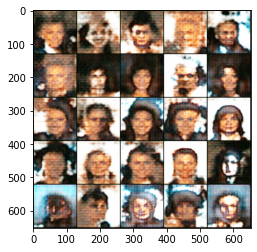

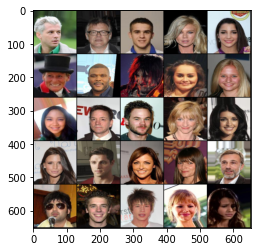

Epoch: 11: Step 875: Generator loss: 29.19544437953404, critic loss: -10.316627646854949


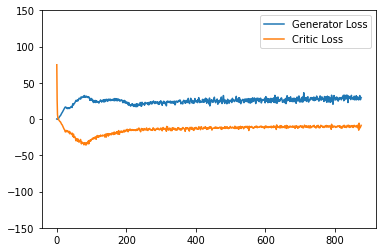

Saving checkpoint:  910 35
Saved checkpoint


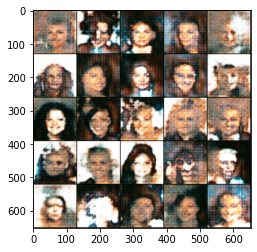

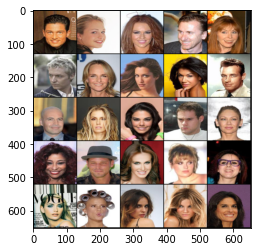

Epoch: 11: Step 910: Generator loss: 29.001346697126117, critic loss: -9.886893776484895


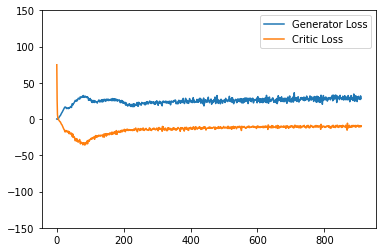

Saving checkpoint:  945 35
Saved checkpoint


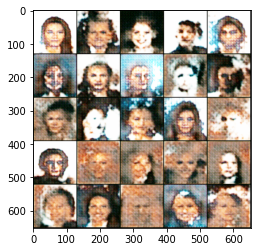

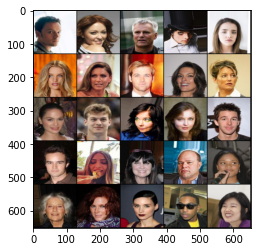

Epoch: 11: Step 945: Generator loss: 29.15489774431501, critic loss: -9.835740585327148


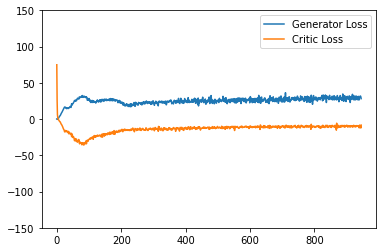

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  980 35
Saved checkpoint


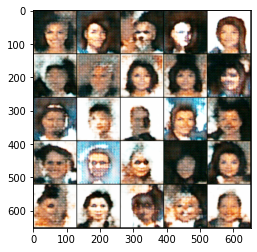

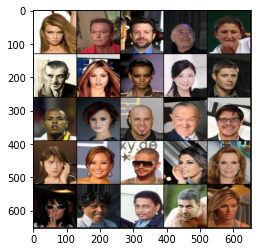

Epoch: 12: Step 980: Generator loss: 29.57794385637556, critic loss: -9.719995986393519


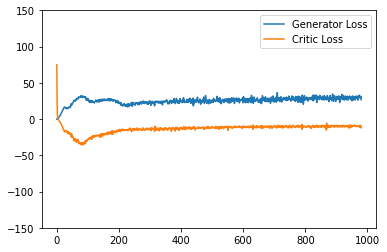

Saving checkpoint:  1015 35
Saved checkpoint


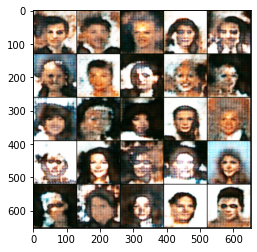

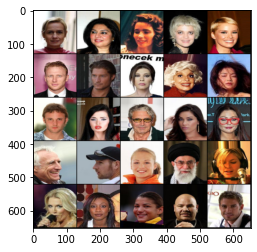

Epoch: 12: Step 1015: Generator loss: 29.815669740949357, critic loss: -9.475926889692033


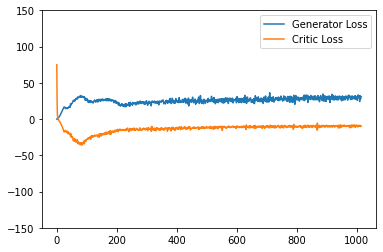

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1050 35
Saved checkpoint


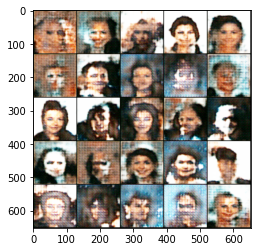

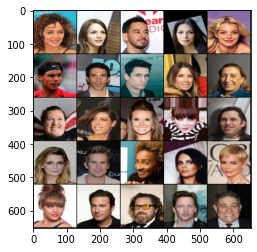

Epoch: 13: Step 1050: Generator loss: 30.299834660121373, critic loss: -9.239188613891601


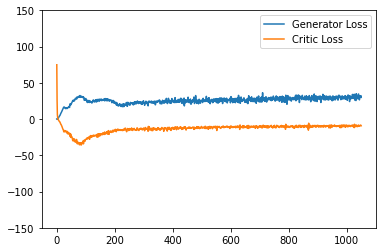

Saving checkpoint:  1085 35
Saved checkpoint


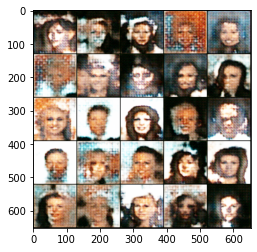

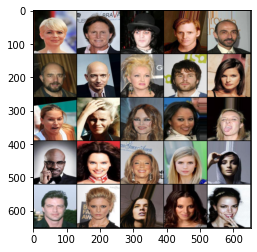

Epoch: 13: Step 1085: Generator loss: 28.91335481916155, critic loss: -8.989498607090539


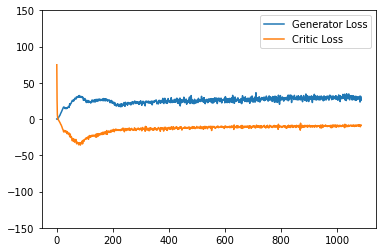

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1120 35
Saved checkpoint


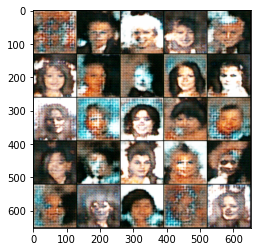

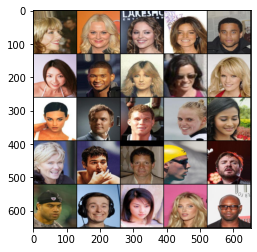

Epoch: 14: Step 1120: Generator loss: 28.817835453578404, critic loss: -8.974894981384276


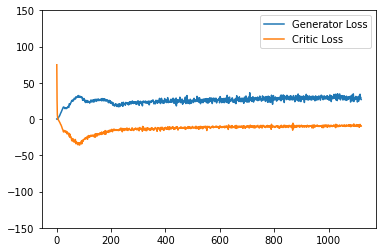

Saving checkpoint:  1155 35
Saved checkpoint


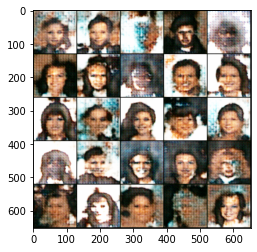

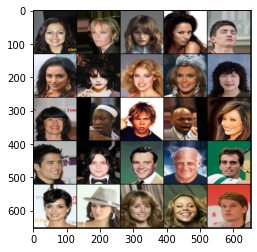

Epoch: 14: Step 1155: Generator loss: 28.891009793962752, critic loss: -8.543511486053468


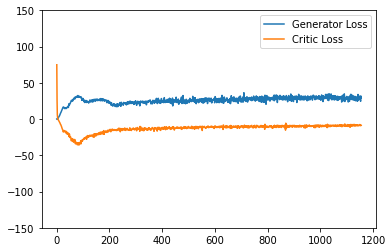

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1190 35
Saved checkpoint


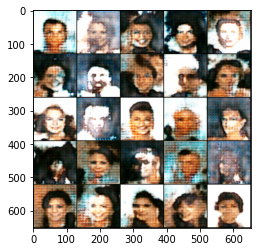

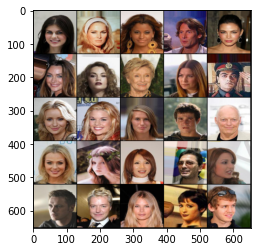

Epoch: 15: Step 1190: Generator loss: 28.533011082240513, critic loss: -8.813754739761354


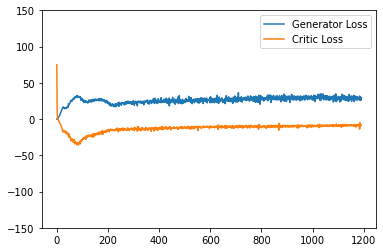

Saving checkpoint:  1225 35
Saved checkpoint


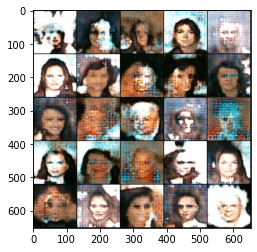

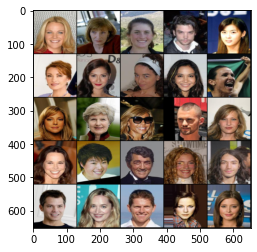

Epoch: 15: Step 1225: Generator loss: 27.958626774379184, critic loss: -8.702129393986295


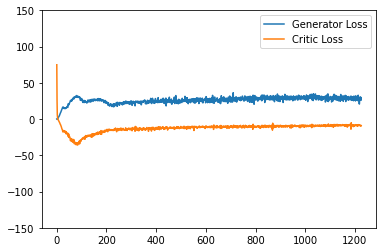

Saving checkpoint:  1260 35
Saved checkpoint


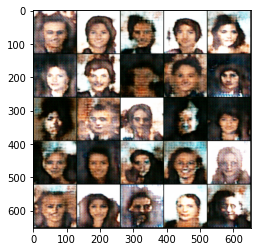

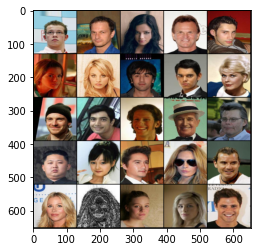

Epoch: 15: Step 1260: Generator loss: 28.37469618661063, critic loss: -8.499350594111853


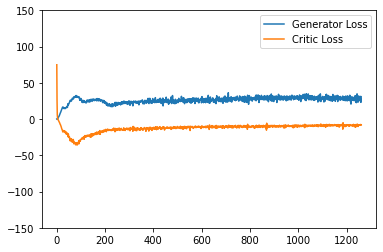

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1295 35
Saved checkpoint


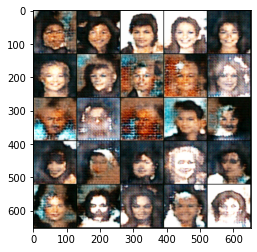

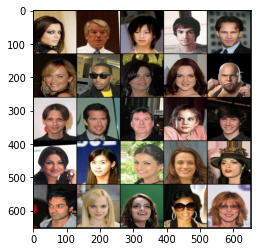

Epoch: 16: Step 1295: Generator loss: 27.49576563153948, critic loss: -8.435638502665928


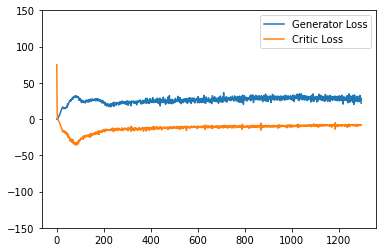

Saving checkpoint:  1330 35
Saved checkpoint


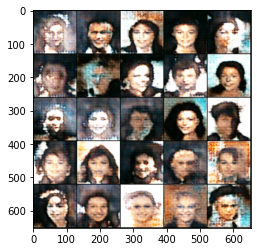

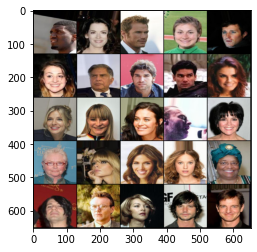

Epoch: 16: Step 1330: Generator loss: 27.923426709856304, critic loss: -8.450124059404645


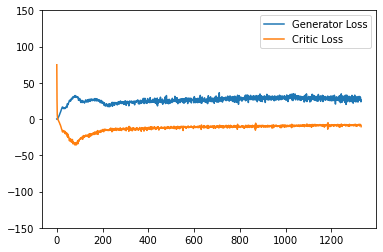

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1365 35
Saved checkpoint


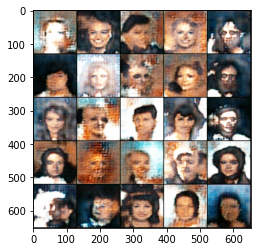

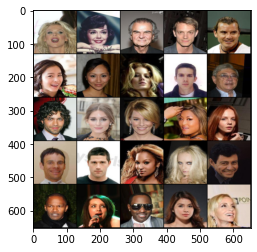

Epoch: 17: Step 1365: Generator loss: 28.26435492379325, critic loss: -8.517128579275948


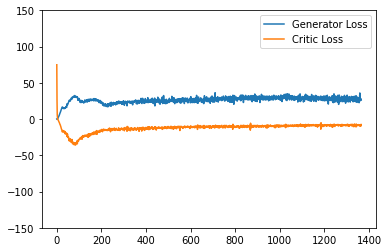

Saving checkpoint:  1400 35
Saved checkpoint


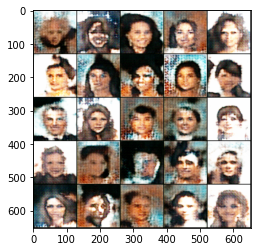

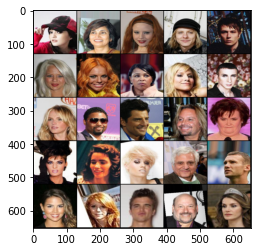

Epoch: 17: Step 1400: Generator loss: 27.693798773629325, critic loss: -8.193773329598562


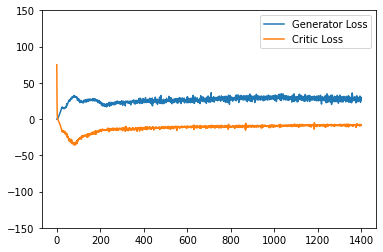

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1435 35
Saved checkpoint


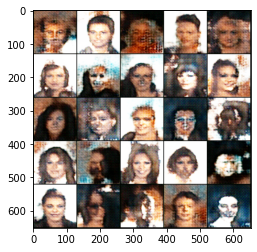

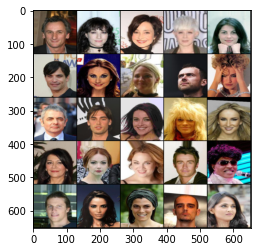

Epoch: 18: Step 1435: Generator loss: 27.931253923688615, critic loss: -8.32891518184117


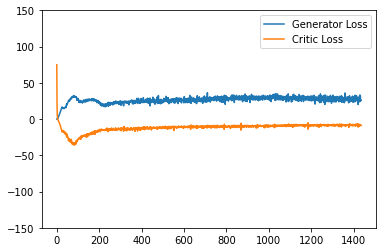

Saving checkpoint:  1470 35
Saved checkpoint


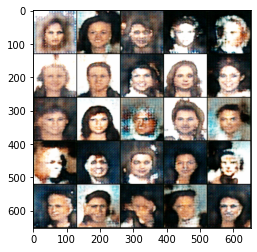

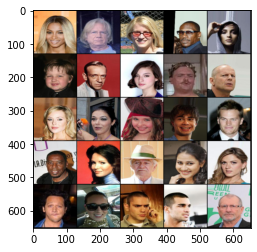

Epoch: 18: Step 1470: Generator loss: 27.66917392185756, critic loss: -8.20145843097142


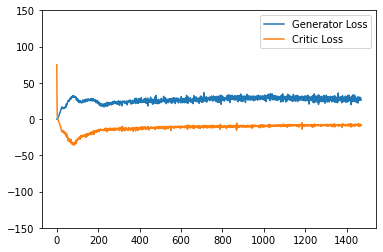

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1505 35
Saved checkpoint


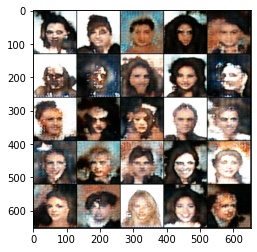

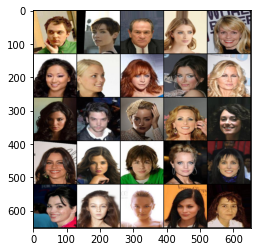

Epoch: 19: Step 1505: Generator loss: 27.32034214564732, critic loss: -8.179922627040321


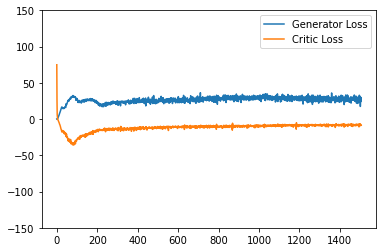

Saving checkpoint:  1540 35
Saved checkpoint


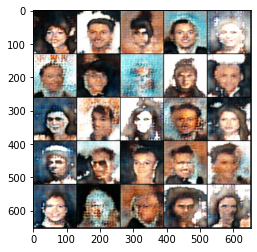

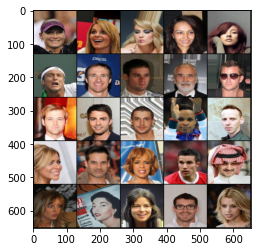

Epoch: 19: Step 1540: Generator loss: 26.733852767944335, critic loss: -8.22729456765311


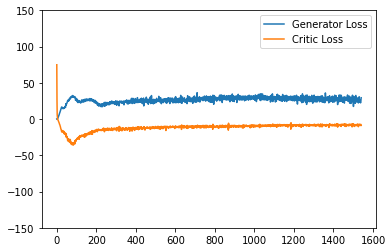

Saving checkpoint:  1575 35
Saved checkpoint


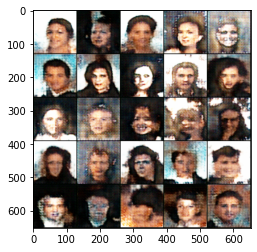

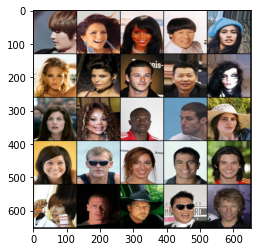

Epoch: 19: Step 1575: Generator loss: 27.45971221923828, critic loss: -8.109462105887275


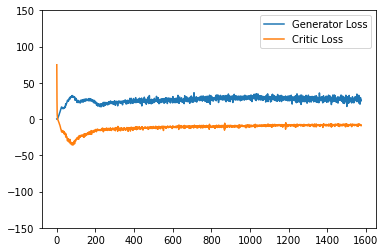

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1610 35
Saved checkpoint


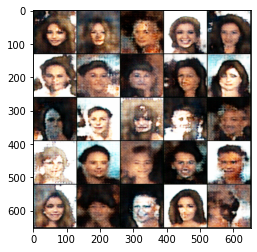

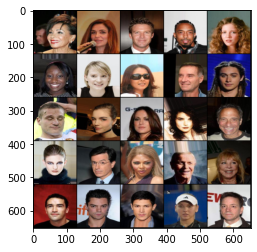

Epoch: 20: Step 1610: Generator loss: 27.177297701154437, critic loss: -8.138723972865513


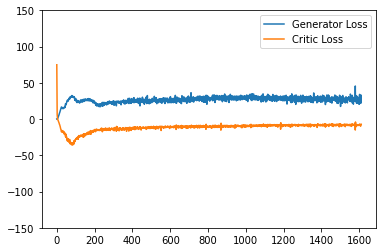

Saving checkpoint:  1645 35
Saved checkpoint


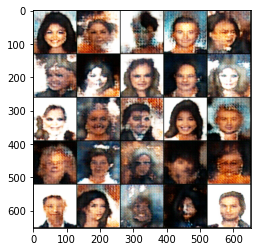

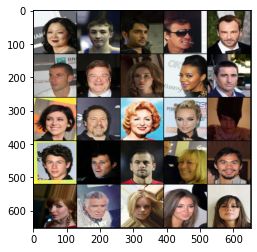

Epoch: 20: Step 1645: Generator loss: 26.949051993233816, critic loss: -8.011573042188374


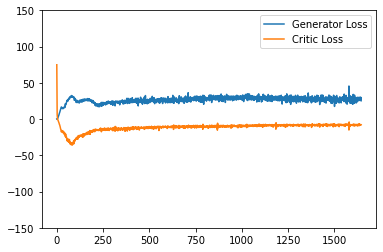

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1680 35
Saved checkpoint


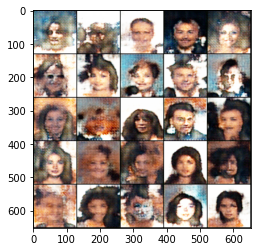

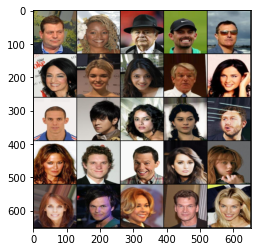

Epoch: 21: Step 1680: Generator loss: 26.69508307320731, critic loss: -8.144219450269427


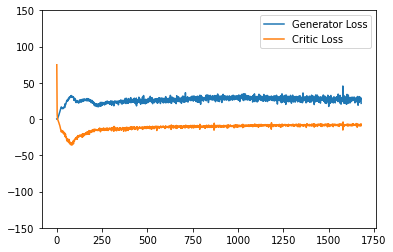

Saving checkpoint:  1715 35
Saved checkpoint


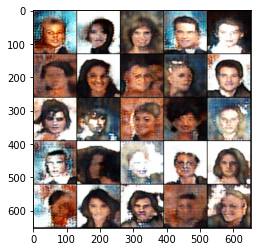

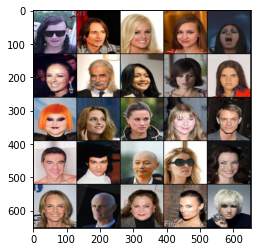

Epoch: 21: Step 1715: Generator loss: 26.87393891470773, critic loss: -7.980780740465434


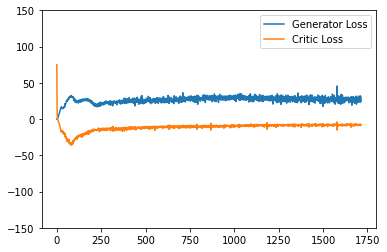

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1750 35
Saved checkpoint


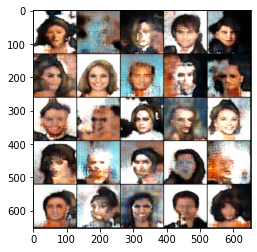

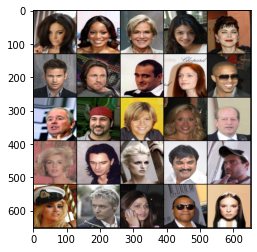

Epoch: 22: Step 1750: Generator loss: 26.714126641409738, critic loss: -8.028439852850777


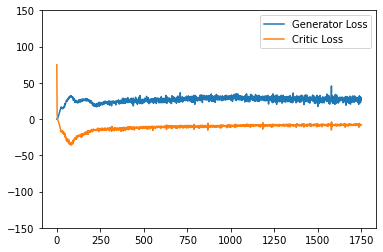

Saving checkpoint:  1785 35
Saved checkpoint


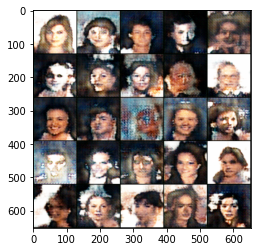

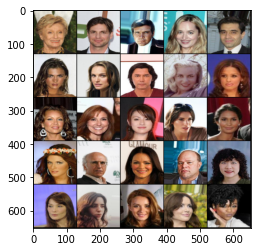

Epoch: 22: Step 1785: Generator loss: 26.970698383876254, critic loss: -8.023854045867921


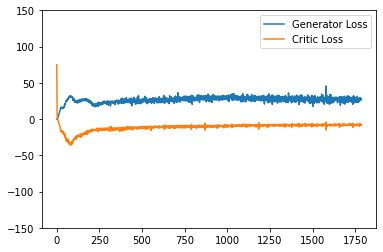

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1820 35
Saved checkpoint


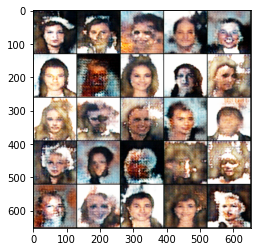

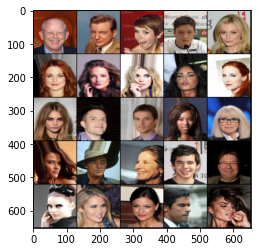

Epoch: 23: Step 1820: Generator loss: 26.685792105538503, critic loss: -7.739729152406963


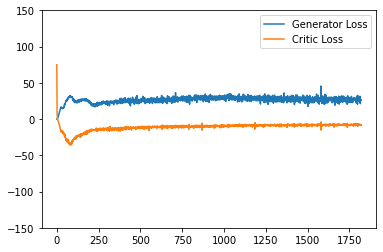

Saving checkpoint:  1855 35
Saved checkpoint


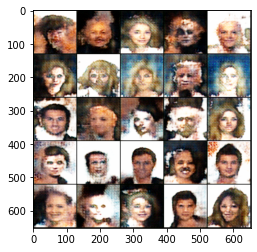

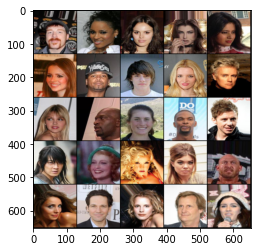

Epoch: 23: Step 1855: Generator loss: 26.060616901942662, critic loss: -8.03102648326329


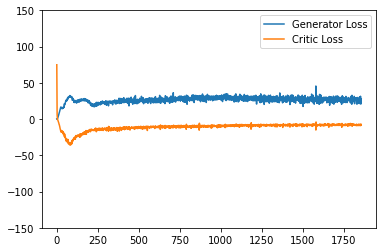

Saving checkpoint:  1890 35
Saved checkpoint


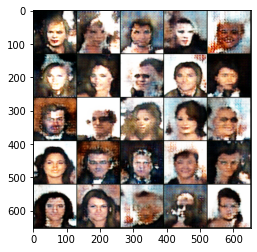

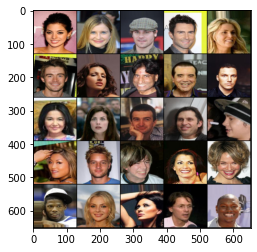

Epoch: 23: Step 1890: Generator loss: 26.46560341971261, critic loss: -7.899530698231288


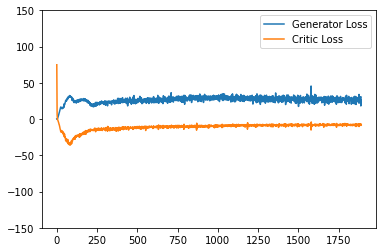

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1925 35
Saved checkpoint


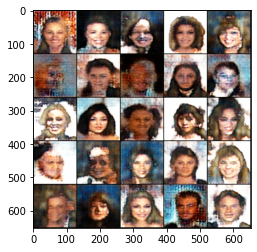

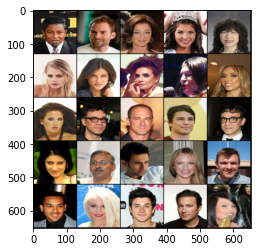

Epoch: 24: Step 1925: Generator loss: 26.073633084978376, critic loss: -7.851632584163122


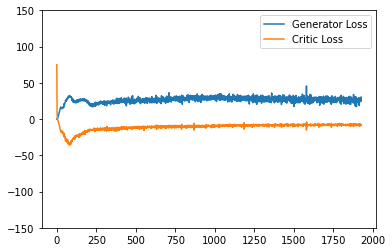

Saving checkpoint:  1960 35
Saved checkpoint


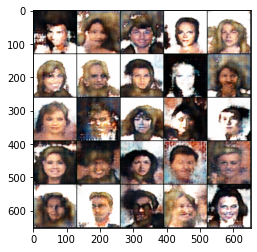

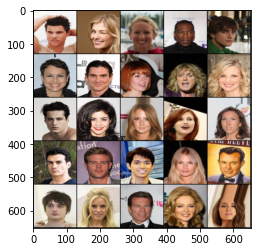

Epoch: 24: Step 1960: Generator loss: 26.527187619890487, critic loss: -7.62711814880371


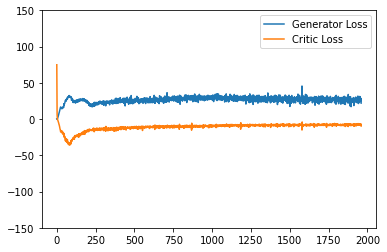

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1995 35
Saved checkpoint


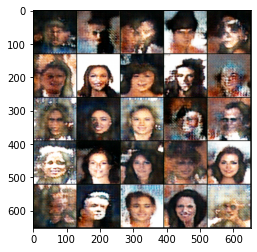

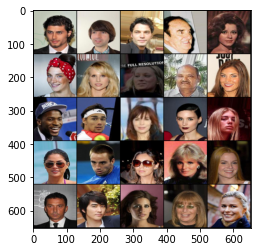

Epoch: 25: Step 1995: Generator loss: 26.009153257097516, critic loss: -7.695176236288889


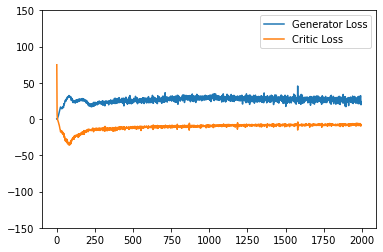

Saving checkpoint:  2030 35
Saved checkpoint


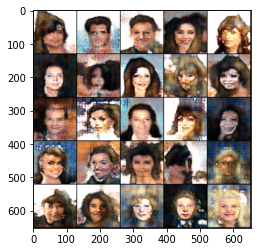

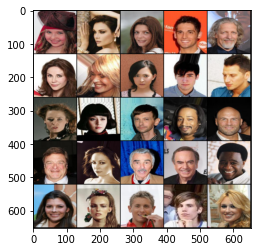

Epoch: 25: Step 2030: Generator loss: 25.573688670567105, critic loss: -7.669185030800957


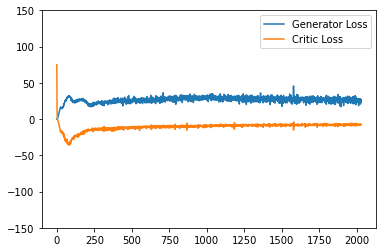

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2065 35
Saved checkpoint


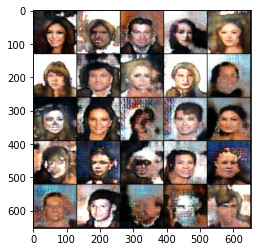

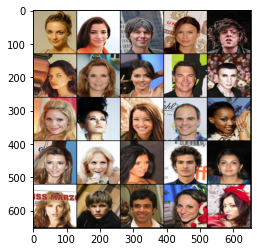

Epoch: 26: Step 2065: Generator loss: 25.218098013741628, critic loss: -7.635424153464179


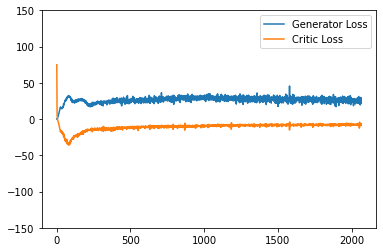

Saving checkpoint:  2100 35
Saved checkpoint


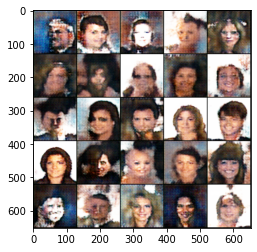

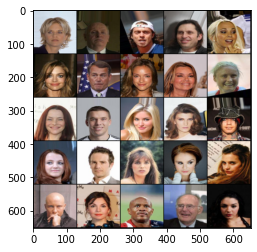

Epoch: 26: Step 2100: Generator loss: 25.78854479108538, critic loss: -7.627410499027797


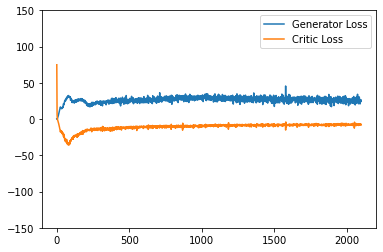

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2135 35
Saved checkpoint


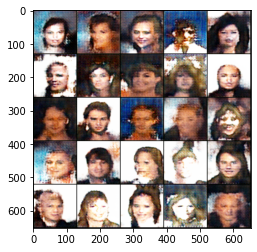

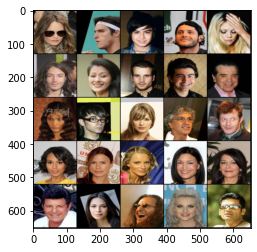

Epoch: 27: Step 2135: Generator loss: 26.103414753505163, critic loss: -7.470756688799177


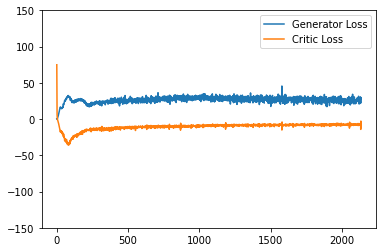

Saving checkpoint:  2170 35
Saved checkpoint


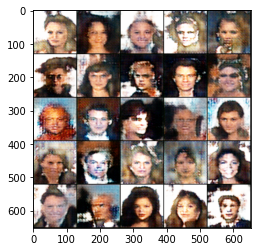

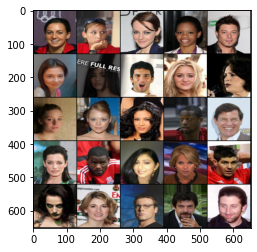

Epoch: 27: Step 2170: Generator loss: 25.69525604248047, critic loss: -7.7909282711574015


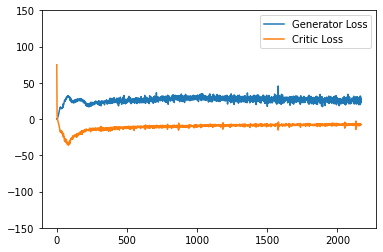

Saving checkpoint:  2205 35
Saved checkpoint


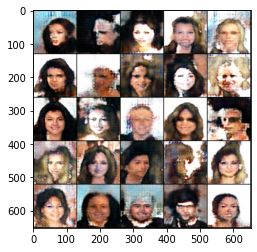

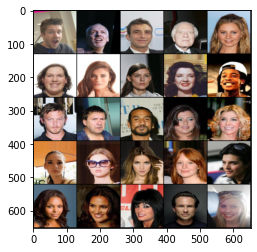

Epoch: 27: Step 2205: Generator loss: 25.540684945242745, critic loss: -7.427561311721802


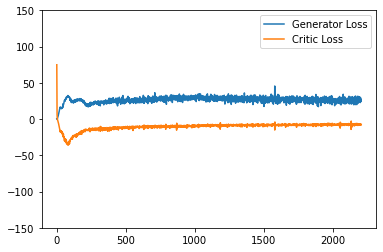

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2240 35
Saved checkpoint


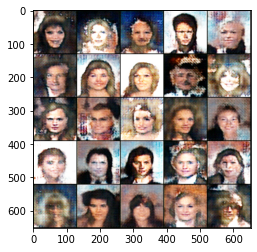

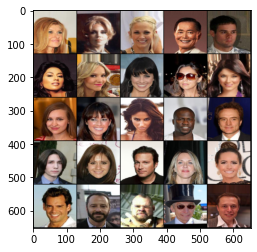

Epoch: 28: Step 2240: Generator loss: 26.104826300484792, critic loss: -7.67968742779323


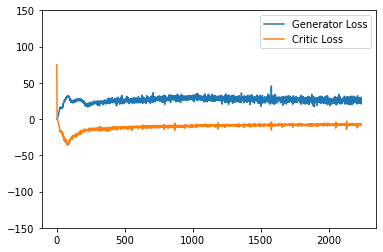

Saving checkpoint:  2275 35
Saved checkpoint


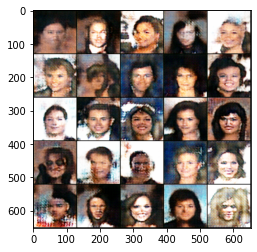

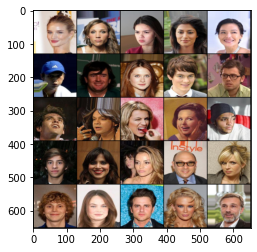

Epoch: 28: Step 2275: Generator loss: 25.330153547014508, critic loss: -7.401772569928849


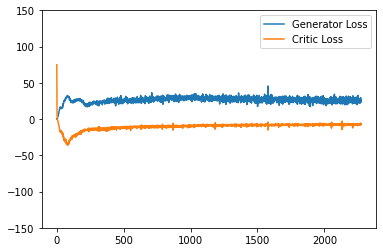

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2310 35
Saved checkpoint


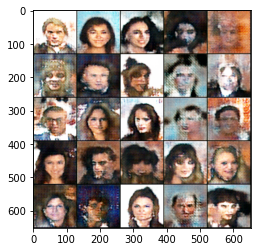

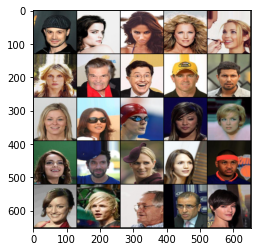

Epoch: 29: Step 2310: Generator loss: 24.880014256068637, critic loss: -7.49448954990932


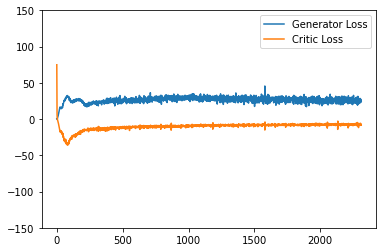

Saving checkpoint:  2345 35
Saved checkpoint


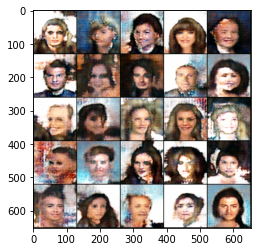

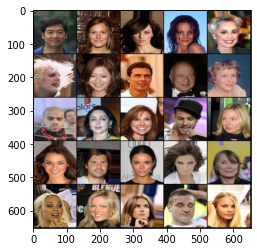

Epoch: 29: Step 2345: Generator loss: 24.439008712768555, critic loss: -7.47946991103036


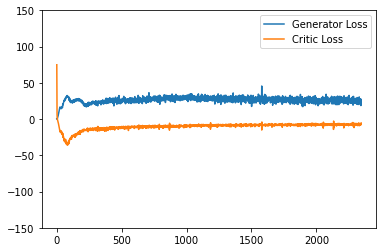

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2380 35
Saved checkpoint


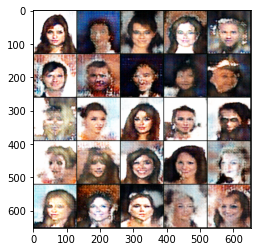

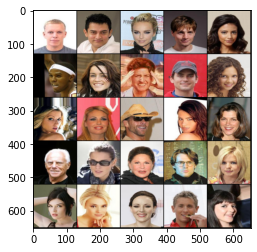

Epoch: 30: Step 2380: Generator loss: 24.802514702933177, critic loss: -7.421535001482282


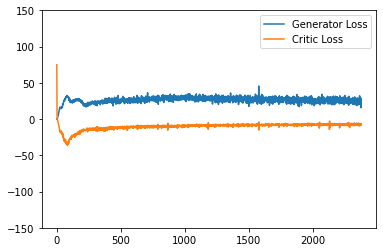

Saving checkpoint:  2415 35
Saved checkpoint


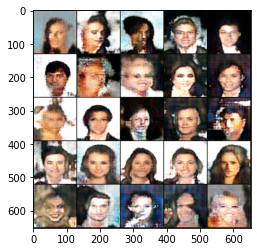

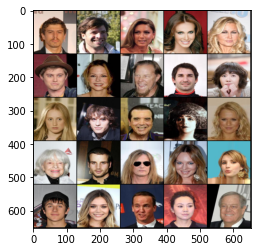

Epoch: 30: Step 2415: Generator loss: 24.605100686209543, critic loss: -7.24840554509844


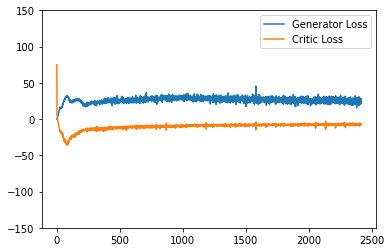

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2450 35
Saved checkpoint


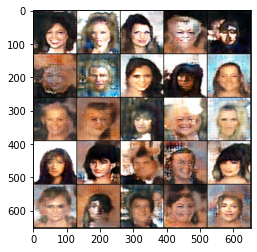

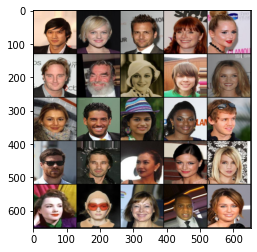

Epoch: 31: Step 2450: Generator loss: 24.80866274152483, critic loss: -7.4824498013087695


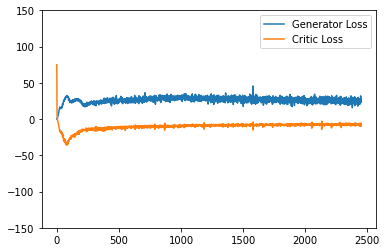

Saving checkpoint:  2485 35
Saved checkpoint


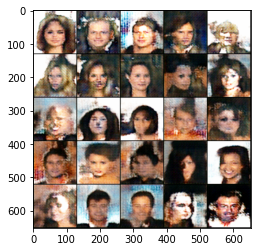

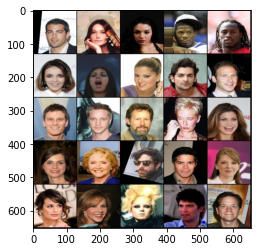

Epoch: 31: Step 2485: Generator loss: 24.391219656808037, critic loss: -7.478246468135288


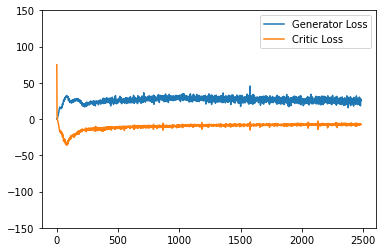

Saving checkpoint:  2520 35
Saved checkpoint


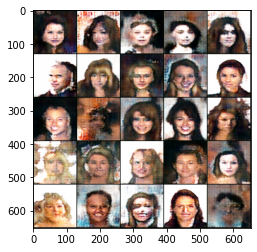

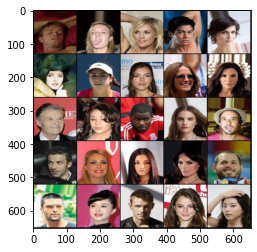

Epoch: 31: Step 2520: Generator loss: 24.389058576311385, critic loss: -7.194240961074829


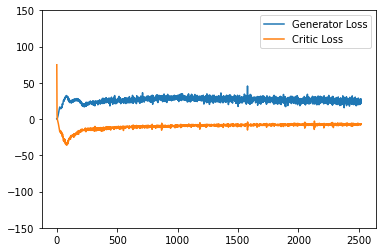

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2555 35
Saved checkpoint


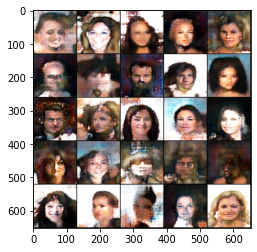

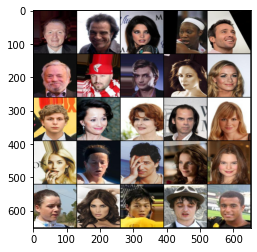

Epoch: 32: Step 2555: Generator loss: 24.798791340419225, critic loss: -7.52526246036802


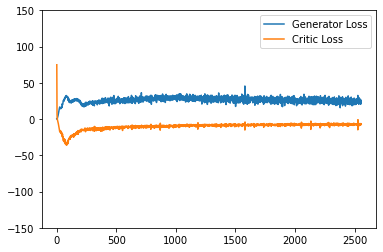

Saving checkpoint:  2590 35
Saved checkpoint


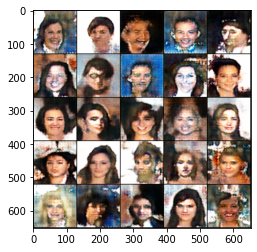

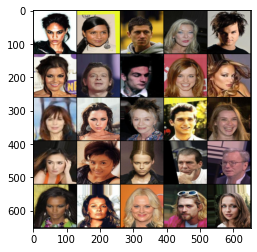

Epoch: 32: Step 2590: Generator loss: 23.88956527709961, critic loss: -7.27345311164856


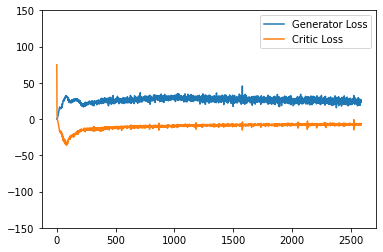

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2625 35
Saved checkpoint


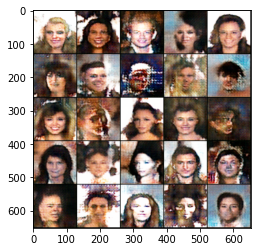

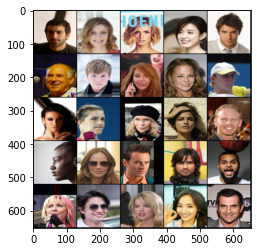

Epoch: 33: Step 2625: Generator loss: 24.277431270054407, critic loss: -7.151064310755048


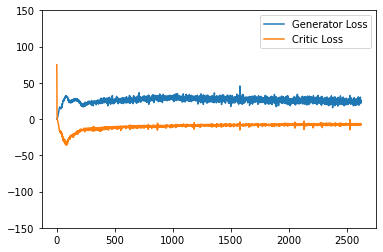

Saving checkpoint:  2660 35
Saved checkpoint


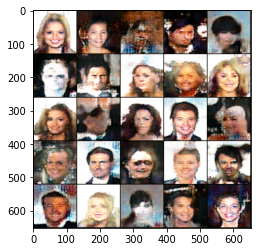

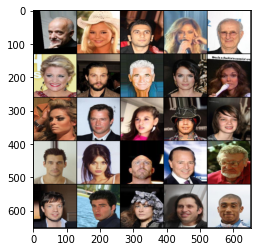

Epoch: 33: Step 2660: Generator loss: 24.10918698992048, critic loss: -7.179121529715401


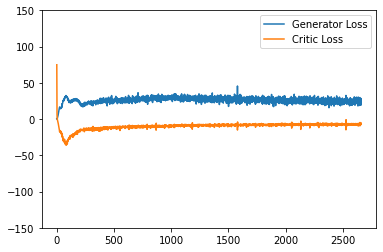

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2695 35
Saved checkpoint


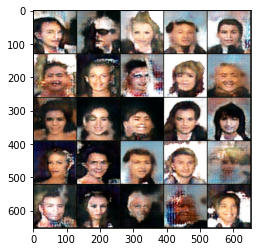

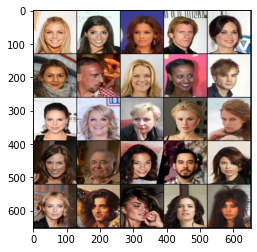

Epoch: 34: Step 2695: Generator loss: 23.73311091831752, critic loss: -7.06181723185948


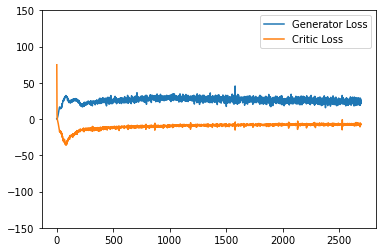

Saving checkpoint:  2730 35
Saved checkpoint


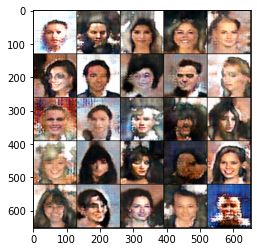

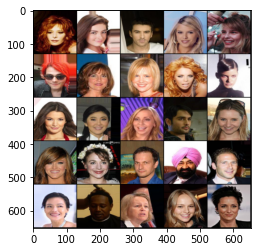

Epoch: 34: Step 2730: Generator loss: 23.491806030273438, critic loss: -7.177819089889526


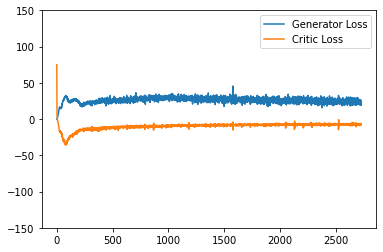

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2765 35
Saved checkpoint


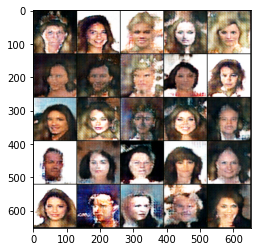

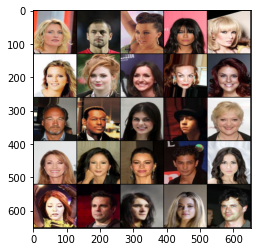

Epoch: 35: Step 2765: Generator loss: 23.471994726998464, critic loss: -7.128216073172431


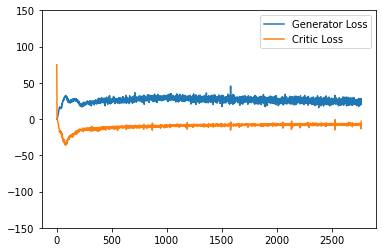

Saving checkpoint:  2800 35
Saved checkpoint


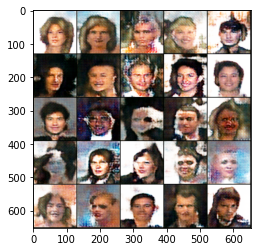

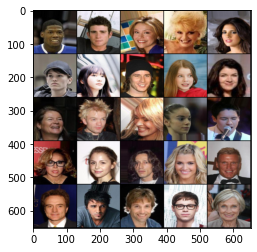

Epoch: 35: Step 2800: Generator loss: 23.24335708618164, critic loss: -7.1467902578626346


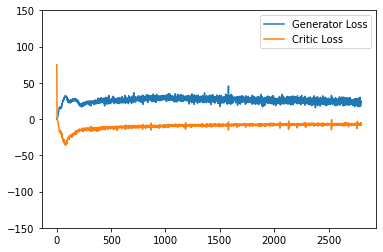

Saving checkpoint:  2835 35
Saved checkpoint


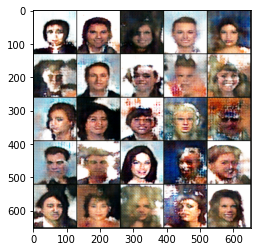

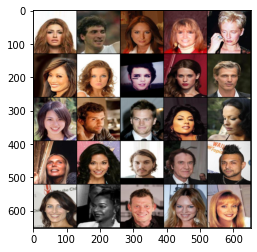

Epoch: 35: Step 2835: Generator loss: 23.558313860212053, critic loss: -7.048531622205461


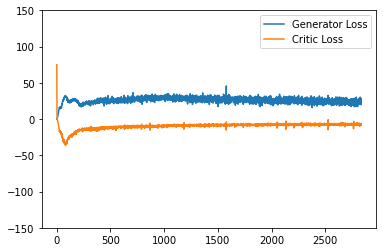

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2870 35
Saved checkpoint


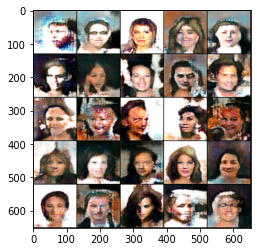

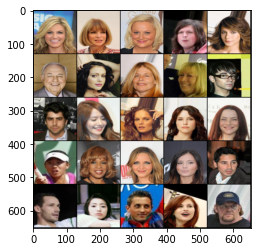

Epoch: 36: Step 2870: Generator loss: 23.289065224783762, critic loss: -7.283237506321499


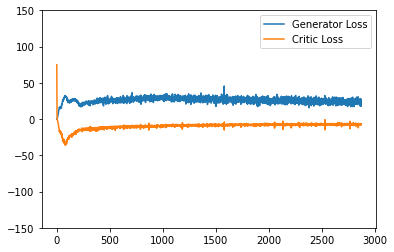

Saving checkpoint:  2905 35
Saved checkpoint


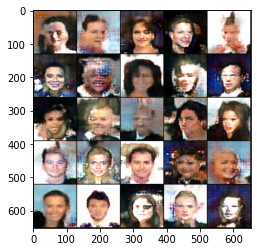

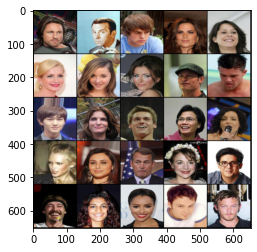

Epoch: 36: Step 2905: Generator loss: 23.70543327331543, critic loss: -7.059460691724507


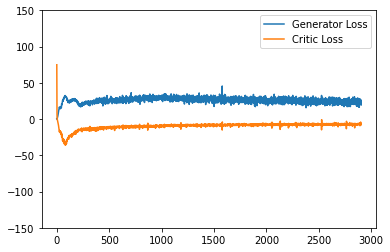

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2940 35
Saved checkpoint


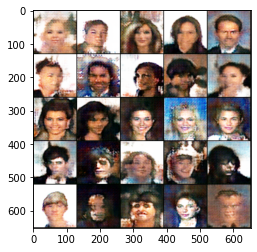

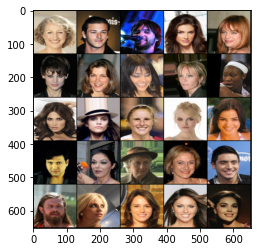

Epoch: 37: Step 2940: Generator loss: 22.71347329275949, critic loss: -6.924287793976919


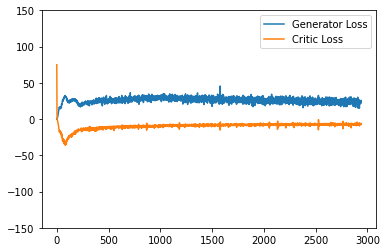

Saving checkpoint:  2975 35
Saved checkpoint


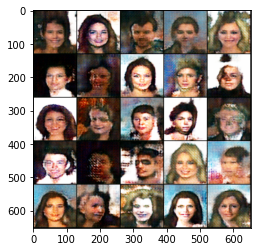

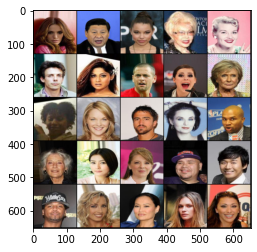

Epoch: 37: Step 2975: Generator loss: 22.71612935747419, critic loss: -7.140786248615808


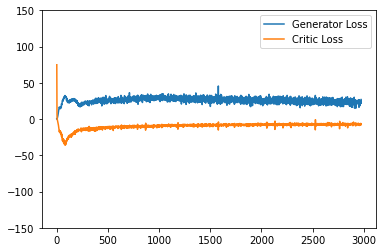

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3010 35
Saved checkpoint


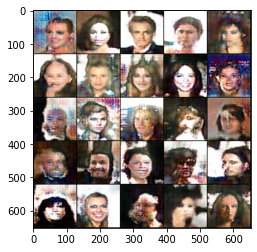

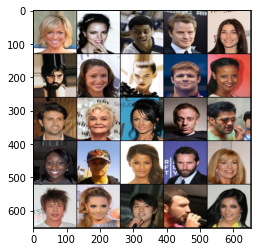

Epoch: 38: Step 3010: Generator loss: 23.07887246268136, critic loss: -6.938265925134931


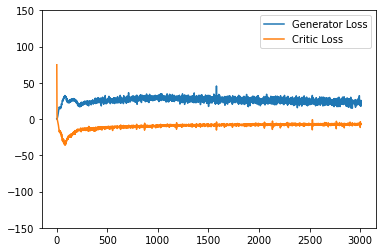

Saving checkpoint:  3045 35
Saved checkpoint


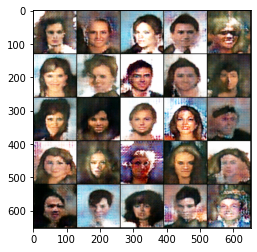

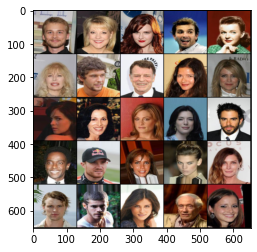

Epoch: 38: Step 3045: Generator loss: 23.58803269522531, critic loss: -7.002434073856899


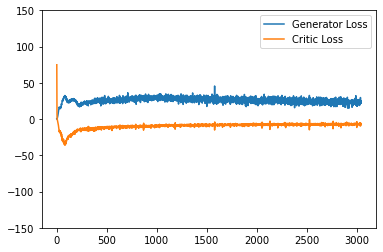

Saving checkpoint:  3080 35
Saved checkpoint


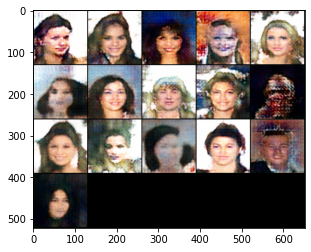

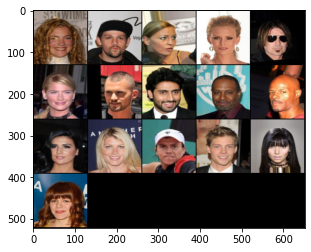

Epoch: 38: Step 3080: Generator loss: 23.520816802978516, critic loss: -7.0370031929016115


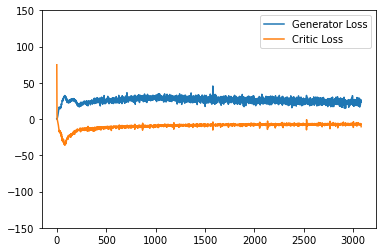

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3115 35
Saved checkpoint


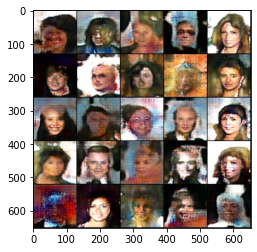

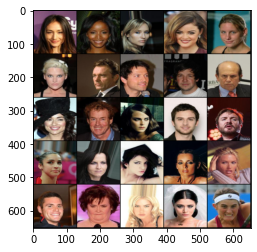

Epoch: 39: Step 3115: Generator loss: 23.034266008649553, critic loss: -6.945234981264385


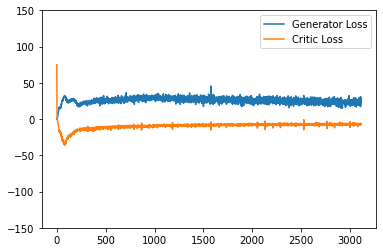

Saving checkpoint:  3150 35
Saved checkpoint


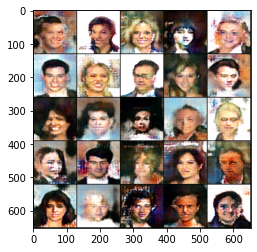

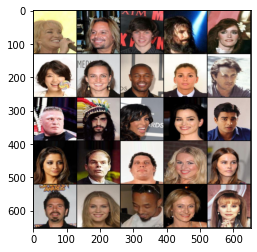

Epoch: 39: Step 3150: Generator loss: 23.523708615984237, critic loss: -6.819103107452393


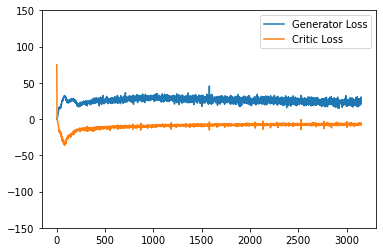

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3185 35
Saved checkpoint


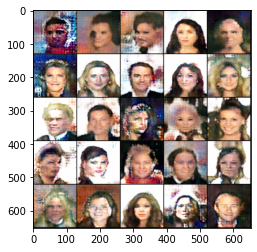

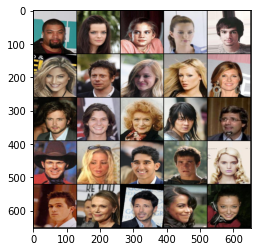

Epoch: 40: Step 3185: Generator loss: 23.381375231061664, critic loss: -6.94480026926313


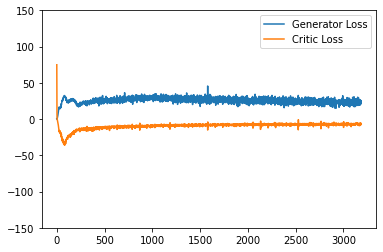

Saving checkpoint:  3220 35
Saved checkpoint


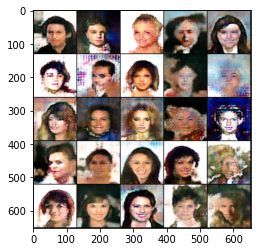

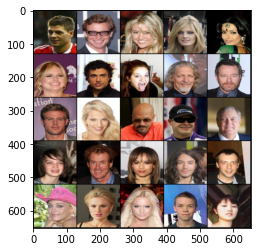

Epoch: 40: Step 3220: Generator loss: 22.27268420628139, critic loss: -6.779083512169974


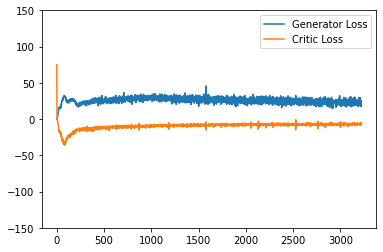

KeyboardInterrupt: ignored

In [24]:
for epoch in range(n_epochs):
  for real, _ in tqdm(dataloader):
    cur_bs = len(real)
    real = real.to(device)

    # Critic
    mean_crit_loss = 0
    for _ in range(crit_cycles):
      crit_opt.zero_grad()

      noise = gen_noise(cur_bs, z_dim)
      fake = gen(noise)
      crit_fake_pred = crit(fake.detach())
      crit_real_pred = crit(real)

      alpha = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True) # 128 x 1 x 1 x 1
      gp = get_gp(real, fake.detach(), crit, alpha)

      crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + gp

      mean_crit_loss += crit_loss.item() / crit_cycles

      crit_loss.backward(retain_graph=True)
      crit_opt.step()
    
    crit_losses += [mean_crit_loss]

    # Generator

    gen_opt.zero_grad()
    noise = gen_noise(cur_bs, z_dim)
    fake = gen(noise)
    crit_fake_pred = crit(fake)

    gen_loss = -crit_fake_pred.mean()

    gen_loss.backward()
    gen_opt.step()

    gen_losses += [gen_loss.item()]

    # Stats
    
    if (wandbact==1):
      wandb.log({'Epoch': epoch, 'Step': cur_step, 'Critic loss':mean_crit_loss, 'Gen loss': gen_loss})

    if cur_step % save_step == 0 and cur_step > 0:
      print("Saving checkpoint: ", cur_step, save_step)
      save_checkpoint("latest")

    if (cur_step % show_step == 0 and cur_step > 0):
      show(fake, wandbactive=1, name='fake')
      show(real, wandbactive=1, name='real')

      gen_mean=sum(gen_losses[-show_step:]) / show_step
      crit_mean = sum(crit_losses[-show_step:]) / show_step
      print(f"Epoch: {epoch}: Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")

      plt.plot(
          range(len(gen_losses)),
          torch.Tensor(gen_losses),
          label="Generator Loss"
      )

      plt.plot(
          range(len(gen_losses)),
          torch.Tensor(crit_losses),
          label="Critic Loss"
      )

      plt.ylim(-150,150)
      plt.legend()
      plt.show()
    
    cur_step+=1